In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

import os
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image

# Adjust this path according to your folder structure in Drive
# For example, if cropped_imgs is directly under "Deep Learning Final Project"
data_root = "/content/drive/MyDrive/Deep_Learning_Final_Project/cropped_imgs"
train_dir = os.path.join(data_root, "train")
val_dir = os.path.join(data_root, "val")
test_dir = os.path.join(data_root, "test")


Mounted at /content/drive


In [ ]:
# Optional: Verify directory structure
print("Train directory contents:", os.listdir(train_dir))
print("Validation directory contents:", os.listdir(val_dir))
print("Test directory contents:", os.listdir(test_dir))

Train directory contents: ['.DS_Store', 'western_grey_squirrel', 'raccoon', 'coyote', 'muledeer', 'turkey', 'rat', 'black_bear', 'otter', 'mouse', 'beaver', 'bob_cat', 'gray_fox', 'goose', 'skunk', 'horse', 'elephant', 'lion', 'mink']
Validation directory contents: ['raccoon', 'western_grey_squirrel', 'coyote', 'turkey', 'muledeer', 'rat', 'black_bear', 'otter', 'mouse', 'bob_cat', 'beaver', 'gray_fox', 'horse', 'mink', 'goose', 'lion', 'skunk', 'elephant']
Test directory contents: ['beaver', 'rat', 'black_bear', 'coyote', 'turkey', 'western_grey_squirrel', 'muledeer', 'raccoon', 'otter', 'mouse', 'mink', 'gray_fox', 'bob_cat', 'lion', 'skunk', 'horse', 'goose', 'elephant']


In [ ]:

# Create a custom dataset class
class AnimalTracksDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.classes = sorted([d for d in os.listdir(root_dir)
                               if os.path.isdir(os.path.join(root_dir, d))])
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}

        self.samples = []
        for class_name in self.classes:
            class_dir = os.path.join(root_dir, class_name)
            for img_name in os.listdir(class_dir):
                if img_name.endswith(('.jpg', '.jpeg', '.png')):
                    self.samples.append((os.path.join(class_dir, img_name),
                                         self.class_to_idx[class_name]))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_path, label = self.samples[idx]
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        return image, label

# Define transformations
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

# Create datasets
train_dataset = AnimalTracksDataset(train_dir, transform=transform)
val_dataset = AnimalTracksDataset(val_dir, transform=transform)
test_dataset = AnimalTracksDataset(test_dir, transform=transform)

# Create dataloaders
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Print some information about the datasets
print(f"Number of training samples: {len(train_dataset)}")
print(f"Number of validation samples: {len(val_dataset)}")
print(f"Number of test samples: {len(test_dataset)}")
print(f"Number of classes: {len(train_dataset.classes)}")
print(f"Classes: {train_dataset.classes}")

Number of training samples: 2514
Number of validation samples: 346
Number of test samples: 719
Number of classes: 18
Classes: ['beaver', 'black_bear', 'bob_cat', 'coyote', 'elephant', 'goose', 'gray_fox', 'horse', 'lion', 'mink', 'mouse', 'muledeer', 'otter', 'raccoon', 'rat', 'skunk', 'turkey', 'western_grey_squirrel']


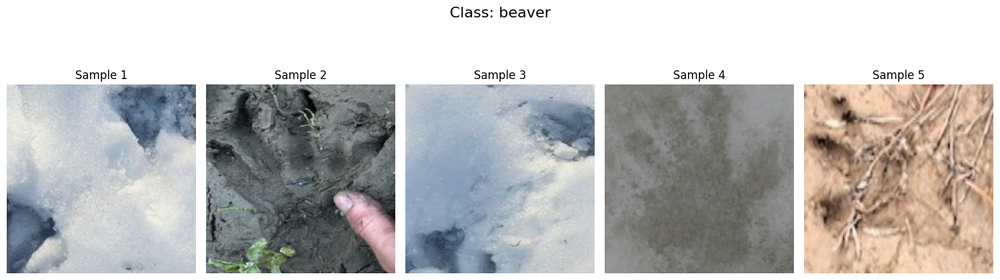

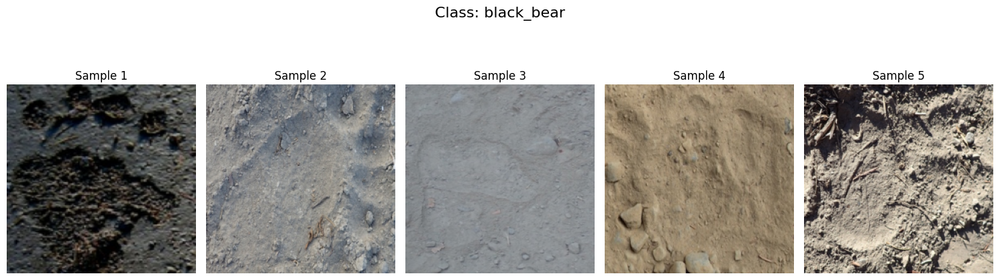

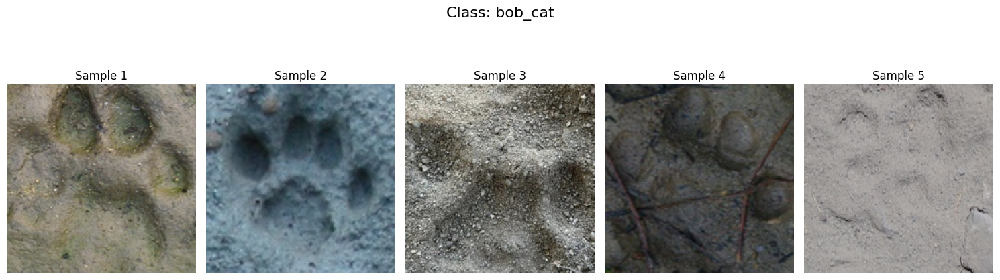

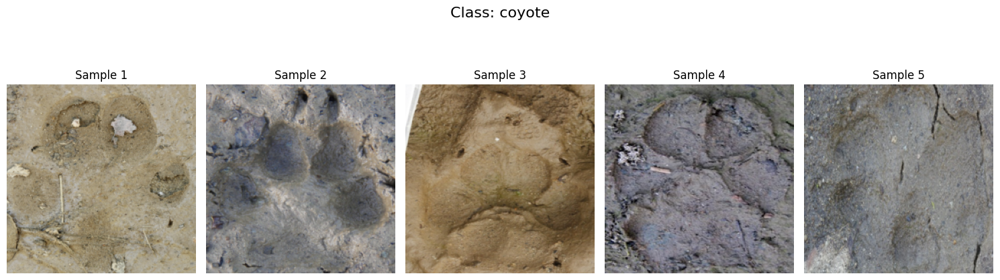

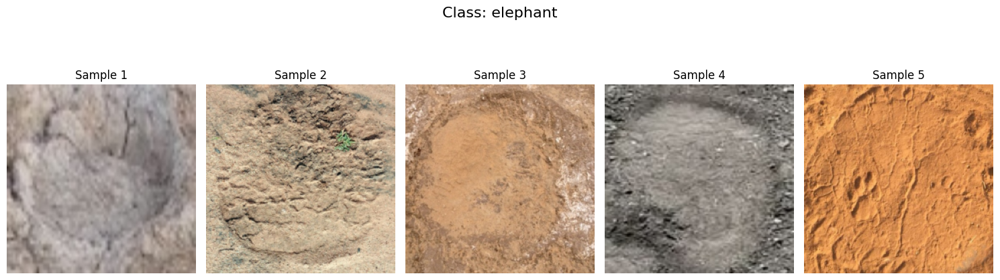

...

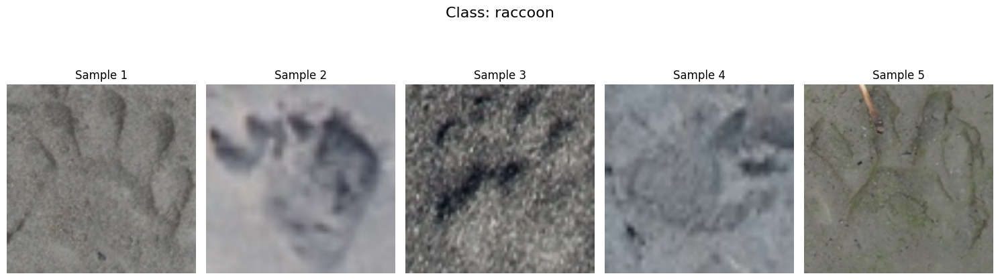

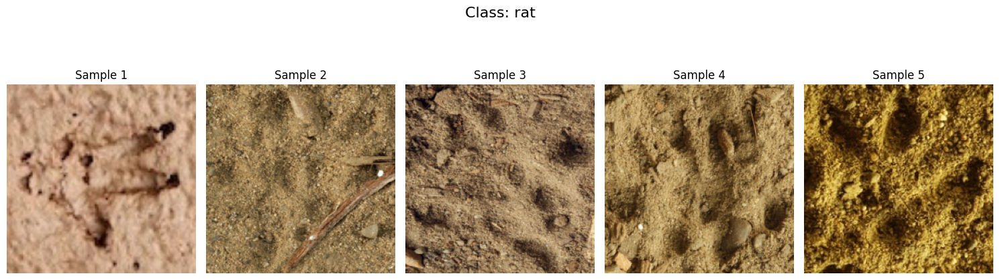

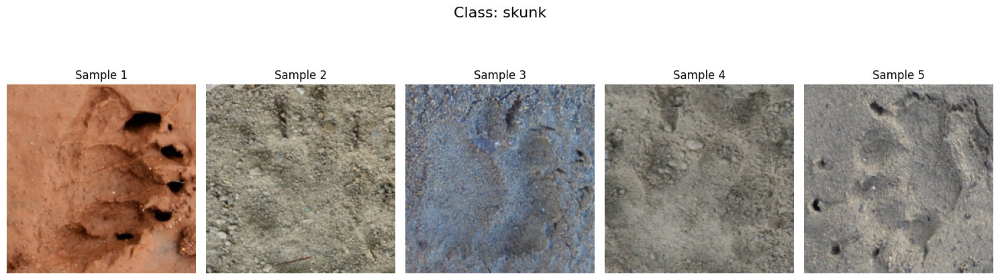

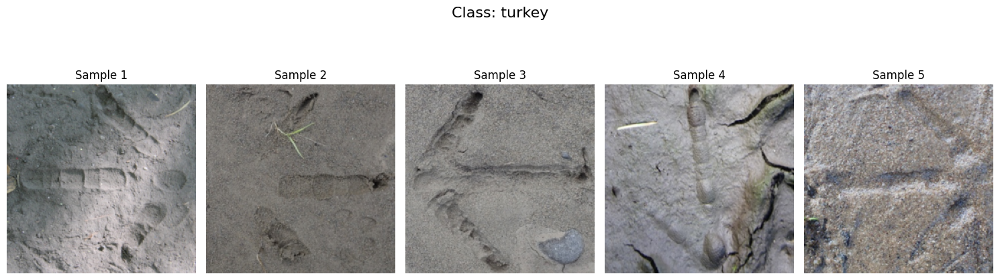

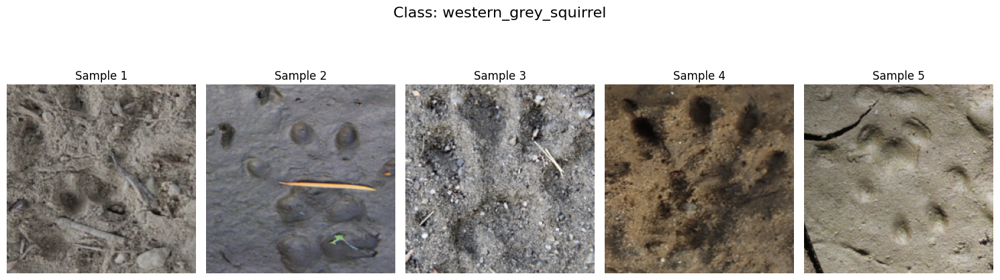

In [ ]:
import matplotlib.pyplot as plt
import random
import numpy as np

def display_class_images(dataset, num_images=5):
    """
    Displays a specified number of random images from each class in the dataset.
    """
    # Create a dictionary mapping class index to list of image indices
    class_to_indices = {i: [] for i in range(len(dataset.classes))}

    # Populate the dictionary
    for idx, (_, label) in enumerate(dataset.samples):
        class_to_indices[label].append(idx)

    # Display images for each class
    for class_idx, class_name in enumerate(dataset.classes):
        # Get indices of images belonging to this class
        indices = class_to_indices[class_idx]

        # Select random images (or all if fewer than num_images exist)
        selected_indices = random.sample(indices, min(num_images, len(indices)))

        # Create a figure
        fig, axes = plt.subplots(1, len(selected_indices), figsize=(15, 5))

        # Display each selected image
        for i, idx in enumerate(selected_indices):
            # Get the image and convert from tensor to numpy array for display
            image, _ = dataset[idx]

            # Convert tensor to numpy array and transpose to correct dimensions
            img_np = image.numpy().transpose(1, 2, 0)

            # Denormalize the image for display
            mean = np.array([0.485, 0.456, 0.406])
            std = np.array([0.229, 0.224, 0.225])
            img_np = std * img_np + mean

            # Clip values to be between 0 and 1
            img_np = np.clip(img_np, 0, 1)

            # Display the image
            if len(selected_indices) > 1:
                axes[i].imshow(img_np)
                axes[i].set_title(f"Sample {i+1}")
                axes[i].axis('off')
            else:
                axes.imshow(img_np)
                axes.set_title(f"Sample {i+1}")
                axes.axis('off')

        plt.suptitle(f"Class: {class_name}", fontsize=16)
        plt.tight_layout()
        plt.show()

# Call the function to display images from the training dataset
display_class_images(train_dataset, 5)

In [ ]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import copy
import random
from tqdm import tqdm
from sklearn.metrics import confusion_matrix
import itertools
import time

# Custom animal tracks dataset class
class AnimalTracksDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.classes = sorted([d for d in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, d))])
        self.class_to_idx = {cls_name: i for i, cls_name in enumerate(self.classes)}

        self.samples = []
        for class_name in self.classes:
            class_dir = os.path.join(root_dir, class_name)
            for img_name in os.listdir(class_dir):
                if img_name.endswith(('.jpg', '.jpeg', '.png')):
                    self.samples.append((os.path.join(class_dir, img_name), self.class_to_idx[class_name]))

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        img_path, label = self.samples[idx]
        image = Image.open(img_path).convert('RGB')

        if self.transform:
            image = self.transform(image)

        return image, label

# Function to plot confusion matrix
def plot_confusion_matrix(cm, class_names, normalize=True, title='Confusion Matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    plt.figure(figsize=(10, 8))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()

    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names, rotation=45, ha="right")
    plt.yticks(tick_marks, class_names)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        if cm[i, j] > 0:
            plt.text(j, i, format(cm[i, j], fmt),
                    horizontalalignment="center",
                    color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

    return plt

# Display sample images
def display_class_images(dataset, num_images=5):
    # Create a dictionary mapping class index to list of image indices
    class_to_indices = {i: [] for i in range(len(dataset.classes))}

    # Populate the dictionary
    for idx, (_, label) in enumerate(dataset.samples):
        class_to_indices[label].append(idx)

    # Display images for each class
    for class_idx, class_name in enumerate(dataset.classes):
        # Get indices of images belonging to this class
        indices = class_to_indices[class_idx]

        # Select random images (or all if fewer than num_images exist)
        selected_indices = random.sample(indices, min(num_images, len(indices)))

        # Create a figure
        fig, axes = plt.subplots(1, len(selected_indices), figsize=(15, 5))

        # Display each selected image
        for i, idx in enumerate(selected_indices):
            # Get the image and convert from tensor to numpy array for display
            image, _ = dataset[idx]

            # Convert tensor to numpy array and transpose to correct dimensions
            img_np = image.numpy().transpose(1, 2, 0)

            # Denormalize the image for display
            mean = np.array([0.485, 0.456, 0.406])
            std = np.array([0.229, 0.224, 0.225])
            img_np = std * img_np + mean

            # Clip values to be between 0 and 1
            img_np = np.clip(img_np, 0, 1)

            # Display the image
            if len(selected_indices) > 1:
                axes[i].imshow(img_np)
                axes[i].set_title(f"Sample {i+1}")
                axes[i].axis('off')
            else:
                axes.imshow(img_np)
                axes.set_title(f"Sample {i+1}")
                axes.axis('off')

        plt.suptitle(f"Class: {class_name}", fontsize=16)
        plt.tight_layout()
        plt.show()

# Training function
def train_model(model, train_loader, val_loader, criterion, optimizer,
                scheduler, num_epochs, device):
    """
    Simple training function without pickling issues
    """
    since = time.time()

    # Initialize tracking variables
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    train_losses = []
    val_losses = []
    train_accs = []
    val_accs = []

    # For each epoch
    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}')
        print('-' * 10)

        # Training phase
        model.train()
        running_loss = 0.0
        running_corrects = 0
        total_samples = 0

        # Iterate over training data
        for inputs, labels in tqdm(train_loader, desc="Training"):
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Zero the parameter gradients
            optimizer.zero_grad()

            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)

            # Backward pass and optimize
            loss.backward()
            optimizer.step()

            # Statistics
            _, preds = torch.max(outputs, 1)
            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)
            total_samples += inputs.size(0)

        # Step the scheduler
        if scheduler:
            scheduler.step()

        # Calculate epoch metrics for training
        epoch_loss = running_loss / total_samples
        epoch_acc = running_corrects.double() / total_samples
        train_losses.append(epoch_loss)
        train_accs.append(epoch_acc.item())

        print(f'Training Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

        # Validation phase
        model.eval()
        running_loss = 0.0
        running_corrects = 0
        total_samples = 0
        all_preds = []
        all_labels = []

        # No gradients needed for validation
        with torch.no_grad():
            for inputs, labels in tqdm(val_loader, desc="Validation"):
                inputs = inputs.to(device)
                labels = labels.to(device)

                # Forward pass
                outputs = model(inputs)
                _, preds = torch.max(outputs, 1)
                loss = criterion(outputs, labels)

                # Statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                total_samples += inputs.size(0)

                # Store predictions and labels for confusion matrix
                all_preds.extend(preds.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

        # Calculate epoch metrics for validation
        epoch_loss = running_loss / total_samples
        epoch_acc = running_corrects.double() / total_samples
        val_losses.append(epoch_loss)
        val_accs.append(epoch_acc.item())

        print(f'Validation Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

        # Save best model
        if epoch_acc > best_acc:
            best_acc = epoch_acc
            best_model_wts = copy.deepcopy(model.state_dict())
            print(f'New best model with accuracy: {best_acc:.4f}')

        print()

    # Training complete
    time_elapsed = time.time() - since
    print(f'Training completed in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best validation accuracy: {best_acc:.4f}')

    # Load best model weights
    model.load_state_dict(best_model_wts)

    # Plot training curves
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(range(1, num_epochs+1), train_losses, label='Training Loss')
    plt.plot(range(1, num_epochs+1), val_losses, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(range(1, num_epochs+1), train_accs, label='Training Accuracy')
    plt.plot(range(1, num_epochs+1), val_accs, label='Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.show()

    return model, best_acc

# Evaluation function
def evaluate_model(model, data_loader, device, class_names=None):
    """
    Evaluates the model on a given dataset
    """
    model.eval()
    running_corrects = 0
    total_samples = 0
    all_preds = []
    all_labels = []

    # No gradients needed for evaluation
    with torch.no_grad():
        for inputs, labels in tqdm(data_loader, desc="Evaluating"):
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            # Statistics
            running_corrects += torch.sum(preds == labels.data)
            total_samples += inputs.size(0)

            # Store predictions and labels for confusion matrix
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    # Calculate metrics
    accuracy = running_corrects.double() / total_samples

    # Create confusion matrix
    confusion_mat = confusion_matrix(all_labels, all_preds)

    # If class names are provided, plot confusion matrix
    if class_names:
        plt.figure(figsize=(10, 8))
        plot_confusion_matrix(confusion_mat, class_names)
        plt.title('Test Set Confusion Matrix')
        plt.show()

        # Calculate per-class accuracy
        print("\nPer-class accuracy:")
        for i, class_name in enumerate(class_names):
            class_total = np.sum(np.array(all_labels) == i)
            if class_total > 0:
                class_correct = confusion_mat[i, i]
                class_acc = class_correct / class_total
                print(f"{class_name}: {class_acc:.4f}")

    return accuracy.item(), confusion_mat

In [ ]:
import os
import time, copy, random
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import transforms, models
import matplotlib.pyplot as plt
from tqdm import tqdm
import numpy as np

# Assuming AnimalTracksDataset, evaluate_model, and display_class_images are defined elsewhere
# (they are as in your original code)

def train_model_with_freezing(model, train_loader, val_loader, criterion, optimizer,
                              scheduler, num_epochs, device, freeze_epochs=5):
    """
    Trains the model by freezing all layers except the final classification layer for the first
    'freeze_epochs' epochs, then unfreezes all layers and continues fine tuning.
    A learning rate scheduler is used to update the learning rate during training.
    """
    since = time.time()

    # Initially, freeze all layers except the final fc layer
    for name, param in model.named_parameters():
        if "fc" not in name:
            param.requires_grad = False
    print("Frozen layers except the final fully connected layer.")

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    train_losses = []
    val_losses = []
    train_accs = []
    val_accs = []

    for epoch in range(num_epochs):
        print(f"Epoch {epoch+1}/{num_epochs}")
        print("-" * 10)

        # At the specified epoch, unfreeze all layers for full fine tuning
        if epoch == freeze_epochs:
            print(f"Epoch {epoch+1}: Unfreezing all layers for full fine tuning.")
            for param in model.parameters():
                param.requires_grad = True
            # Reinitialize optimizer to include all parameters
            optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-4)
            # Reinitialize scheduler for the new optimizer
            scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

        # Training phase
        model.train()
        running_loss = 0.0
        running_corrects = 0
        total_samples = 0

        for inputs, labels in tqdm(train_loader, desc="Training"):
            inputs = inputs.to(device)
            labels = labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            _, preds = torch.max(outputs, 1)
            running_loss += loss.item() * inputs.size(0)
            running_corrects += torch.sum(preds == labels.data)
            total_samples += inputs.size(0)

        # Step the scheduler after the training phase for this epoch
        if scheduler:
            scheduler.step()

        epoch_loss = running_loss / total_samples
        epoch_acc = running_corrects.double() / total_samples
        train_losses.append(epoch_loss)
        train_accs.append(epoch_acc.item())

        print(f"Training Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}")

        # Validation phase
        model.eval()
        running_loss = 0.0
        running_corrects = 0
        total_samples = 0
        with torch.no_grad():
            for inputs, labels in tqdm(val_loader, desc="Validation"):
                inputs = inputs.to(device)
                labels = labels.to(device)

                outputs = model(inputs)
                loss = criterion(outputs, labels)
                _, preds = torch.max(outputs, 1)
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
                total_samples += inputs.size(0)

        epoch_loss = running_loss / total_samples
        epoch_acc = running_corrects.double() / total_samples
        val_losses.append(epoch_loss)
        val_accs.append(epoch_acc.item())

        print(f"Validation Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}")

        # Save best model weights
        if epoch_acc > best_acc:
            best_acc = epoch_acc
            best_model_wts = copy.deepcopy(model.state_dict())
            print(f"New best model with accuracy: {best_acc:.4f}")

        print()

    time_elapsed = time.time() - since
    print(f"Training completed in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s")
    print(f"Best validation accuracy: {best_acc:.4f}")

    model.load_state_dict(best_model_wts)

    # Plot training curves
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(range(1, num_epochs+1), train_losses, label="Training Loss")
    plt.plot(range(1, num_epochs+1), val_losses, label="Validation Loss")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(range(1, num_epochs+1), train_accs, label="Training Accuracy")
    plt.plot(range(1, num_epochs+1), val_accs, label="Validation Accuracy")
    plt.xlabel("Epochs")
    plt.ylabel("Accuracy")
    plt.legend()
    plt.show()

    return model, best_acc

Using device: cuda
Number of training samples: 2514
Number of validation samples: 346
Number of test samples: 719
Number of classes: 18
Classes: ['beaver', 'black_bear', 'bob_cat', 'coyote', 'elephant', 'goose', 'gray_fox', 'horse', 'lion', 'mink', 'mouse', 'muledeer', 'otter', 'raccoon', 'rat', 'skunk', 'turkey', 'western_grey_squirrel']


Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 88.6MB/s]


Frozen layers except the final fully connected layer.
Epoch 1/40
----------


Training: 100%|██████████| 79/79 [12:49<00:00,  9.75s/it]


Training Loss: 2.6602 Acc: 0.1778


Validation: 100%|██████████| 11/11 [02:00<00:00, 11.00s/it]


Validation Loss: 2.3425 Acc: 0.2659
New best model with accuracy: 0.2659

Epoch 2/40
----------


Training: 100%|██████████| 79/79 [00:35<00:00,  2.24it/s]


Training Loss: 2.2635 Acc: 0.2947


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.52it/s]


Validation Loss: 2.1657 Acc: 0.3237
New best model with accuracy: 0.3237

Epoch 3/40
----------


Training: 100%|██████████| 79/79 [00:35<00:00,  2.24it/s]


Training Loss: 2.0637 Acc: 0.3660


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.26it/s]


Validation Loss: 2.0927 Acc: 0.3353
New best model with accuracy: 0.3353

Epoch 4/40
----------


Training: 100%|██████████| 79/79 [00:34<00:00,  2.26it/s]


Training Loss: 1.9449 Acc: 0.4029


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.12it/s]


Validation Loss: 2.1420 Acc: 0.3468
New best model with accuracy: 0.3468

Epoch 5/40
----------


Training: 100%|██████████| 79/79 [00:34<00:00,  2.27it/s]


Training Loss: 1.8464 Acc: 0.4368


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.13it/s]


Validation Loss: 2.0404 Acc: 0.3844
New best model with accuracy: 0.3844

Epoch 6/40
----------
Epoch 6: Unfreezing all layers for full fine tuning.


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 2.5232 Acc: 0.2363


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.88it/s]


Validation Loss: 2.2176 Acc: 0.3266

Epoch 7/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.99it/s]


Training Loss: 1.9916 Acc: 0.3477


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.84it/s]


Validation Loss: 2.7975 Acc: 0.3179

Epoch 8/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.99it/s]


Training Loss: 1.7221 Acc: 0.4332


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.86it/s]


Validation Loss: 1.9836 Acc: 0.4509
New best model with accuracy: 0.4509

Epoch 9/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  2.00it/s]


Training Loss: 1.5252 Acc: 0.5111


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.29it/s]


Validation Loss: 1.6434 Acc: 0.4624
New best model with accuracy: 0.4624

Epoch 10/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  2.00it/s]


Training Loss: 1.3487 Acc: 0.5565


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.93it/s]


Validation Loss: 1.6377 Acc: 0.4884
New best model with accuracy: 0.4884

Epoch 11/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  2.00it/s]


Training Loss: 1.2553 Acc: 0.5871


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.92it/s]


Validation Loss: 1.7285 Acc: 0.4855

Epoch 12/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.99it/s]


Training Loss: 1.1492 Acc: 0.6181


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.58it/s]


Validation Loss: 1.5587 Acc: 0.5289
New best model with accuracy: 0.5289

Epoch 13/40
----------


Training: 100%|██████████| 79/79 [00:40<00:00,  1.97it/s]


Training Loss: 0.7874 Acc: 0.7570


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.69it/s]


Validation Loss: 1.2380 Acc: 0.6301
New best model with accuracy: 0.6301

Epoch 14/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.5906 Acc: 0.8150


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.92it/s]


Validation Loss: 1.1633 Acc: 0.6532
New best model with accuracy: 0.6532

Epoch 15/40
----------


Training: 100%|██████████| 79/79 [00:40<00:00,  1.96it/s]


Training Loss: 0.5222 Acc: 0.8353


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.81it/s]


Validation Loss: 1.1842 Acc: 0.6445

Epoch 16/40
----------


Training: 100%|██████████| 79/79 [00:40<00:00,  1.95it/s]


Training Loss: 0.4578 Acc: 0.8540


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.42it/s]


Validation Loss: 1.2004 Acc: 0.6387

Epoch 17/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.4117 Acc: 0.8699


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.90it/s]


Validation Loss: 1.1790 Acc: 0.6445

Epoch 18/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.3825 Acc: 0.8783


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.95it/s]


Validation Loss: 1.2221 Acc: 0.6329

Epoch 19/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.99it/s]


Training Loss: 0.3235 Acc: 0.9037


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.14it/s]


Validation Loss: 1.2155 Acc: 0.6705
New best model with accuracy: 0.6705

Epoch 20/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.2790 Acc: 0.9189


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.96it/s]


Validation Loss: 1.2081 Acc: 0.6590

Epoch 21/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.99it/s]


Training Loss: 0.2824 Acc: 0.9193


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.93it/s]


Validation Loss: 1.1954 Acc: 0.6503

Epoch 22/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.2674 Acc: 0.9320


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.52it/s]


Validation Loss: 1.2021 Acc: 0.6676

Epoch 23/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.2502 Acc: 0.9284


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.74it/s]


Validation Loss: 1.1969 Acc: 0.6561

Epoch 24/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  2.00it/s]


Training Loss: 0.2510 Acc: 0.9316


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.92it/s]


Validation Loss: 1.1940 Acc: 0.6561

Epoch 25/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.2431 Acc: 0.9296


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.90it/s]


Validation Loss: 1.1963 Acc: 0.6532

Epoch 26/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.2413 Acc: 0.9372


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.16it/s]


Validation Loss: 1.1916 Acc: 0.6676

Epoch 27/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.2372 Acc: 0.9352


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.92it/s]


Validation Loss: 1.1958 Acc: 0.6734
New best model with accuracy: 0.6734

Epoch 28/40
----------


Training: 100%|██████████| 79/79 [00:40<00:00,  1.97it/s]


Training Loss: 0.2403 Acc: 0.9272


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.90it/s]


Validation Loss: 1.1970 Acc: 0.6618

Epoch 29/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.2223 Acc: 0.9407


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.23it/s]


Validation Loss: 1.1982 Acc: 0.6561

Epoch 30/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.99it/s]


Training Loss: 0.2389 Acc: 0.9344


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.90it/s]


Validation Loss: 1.1800 Acc: 0.6647

Epoch 31/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.99it/s]


Training Loss: 0.2362 Acc: 0.9332


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.81it/s]


Validation Loss: 1.2062 Acc: 0.6561

Epoch 32/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.99it/s]


Training Loss: 0.2244 Acc: 0.9391


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.89it/s]


Validation Loss: 1.1799 Acc: 0.6647

Epoch 33/40
----------


Training: 100%|██████████| 79/79 [00:40<00:00,  1.97it/s]


Training Loss: 0.2216 Acc: 0.9427


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.39it/s]


Validation Loss: 1.2150 Acc: 0.6561

Epoch 34/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  2.00it/s]


Training Loss: 0.2375 Acc: 0.9348


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.96it/s]


Validation Loss: 1.2102 Acc: 0.6561

Epoch 35/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.99it/s]


Training Loss: 0.2160 Acc: 0.9475


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.94it/s]


Validation Loss: 1.2059 Acc: 0.6561

Epoch 36/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.99it/s]


Training Loss: 0.2185 Acc: 0.9411


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.29it/s]


Validation Loss: 1.1966 Acc: 0.6590

Epoch 37/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.99it/s]


Training Loss: 0.2221 Acc: 0.9459


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.94it/s]


Validation Loss: 1.2043 Acc: 0.6561

Epoch 38/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.2152 Acc: 0.9447


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.88it/s]


Validation Loss: 1.2219 Acc: 0.6590

Epoch 39/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.2240 Acc: 0.9411


Validation: 100%|██████████| 11/11 [00:02<00:00,  3.79it/s]


Validation Loss: 1.1953 Acc: 0.6647

Epoch 40/40
----------


Training: 100%|██████████| 79/79 [00:39<00:00,  1.98it/s]


Training Loss: 0.2303 Acc: 0.9411


Validation: 100%|██████████| 11/11 [00:03<00:00,  3.41it/s]


Validation Loss: 1.2067 Acc: 0.6618

Training completed in 42m 23s
Best validation accuracy: 0.6734


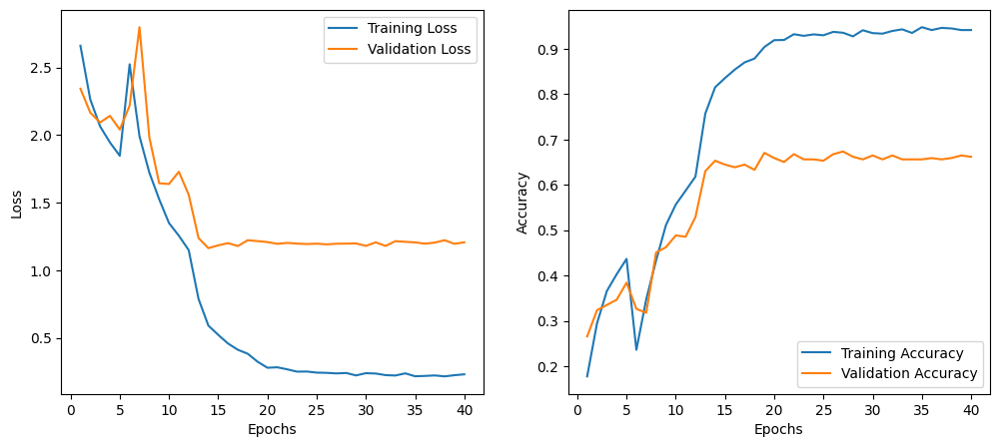

Evaluating: 100%|██████████| 23/23 [04:28<00:00, 11.69s/it]


<Figure size 1000x800 with 0 Axes>

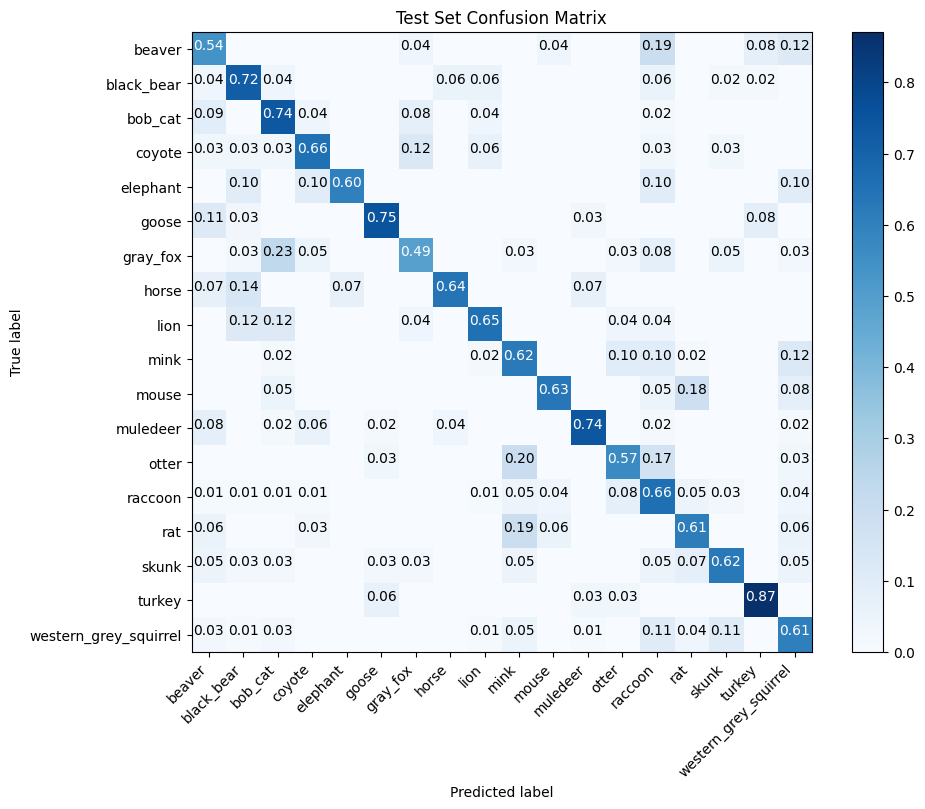


Per-class accuracy:
beaver: 0.5385
black_bear: 0.7170
bob_cat: 0.7358
coyote: 0.6562
elephant: 0.6000
goose: 0.7500
gray_fox: 0.4872
horse: 0.6429
lion: 0.6538
mink: 0.6200
mouse: 0.6316
muledeer: 0.7400
otter: 0.5667
raccoon: 0.6582
rat: 0.6111
skunk: 0.6250
turkey: 0.8710
western_grey_squirrel: 0.6053
Test accuracy: 0.6551
Displaying sample images from the training set:


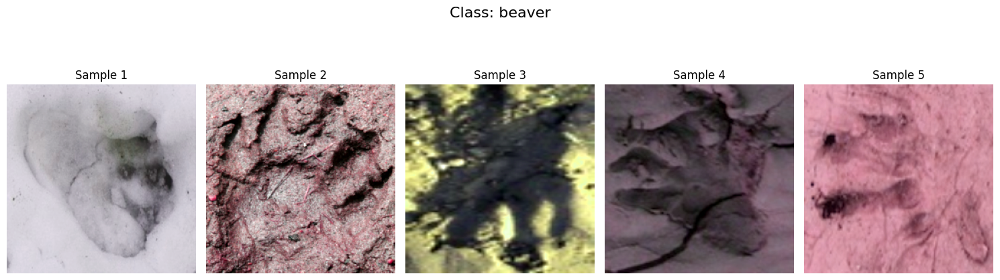

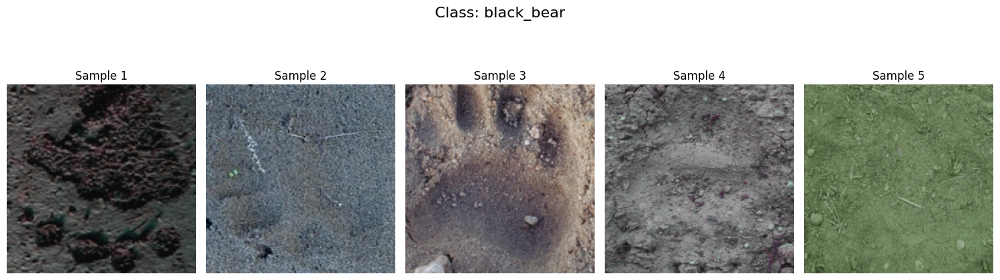

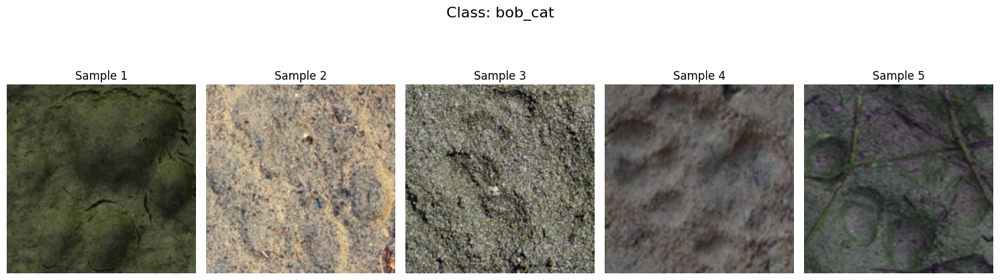

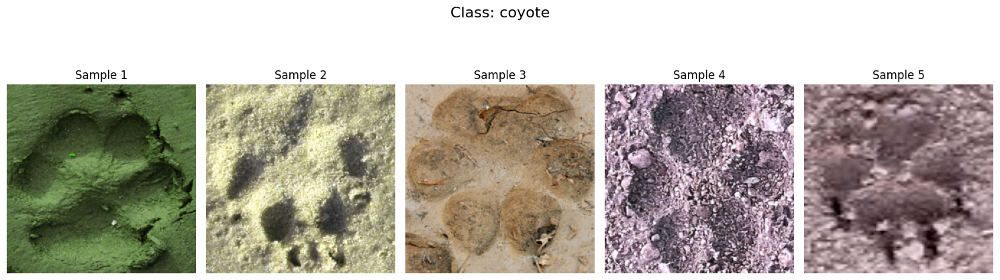

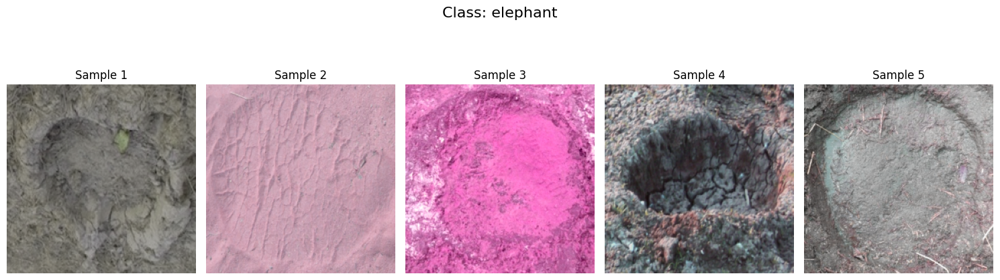

...

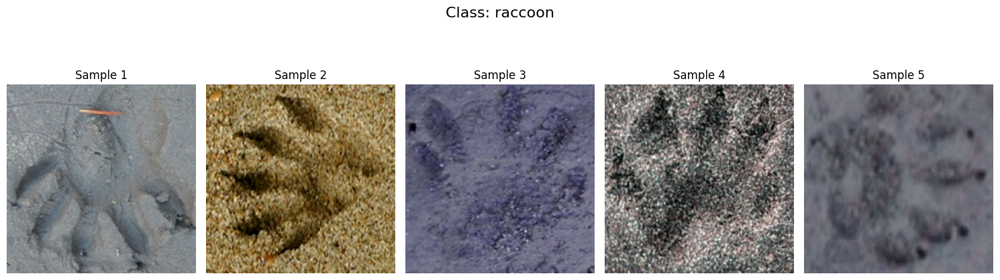

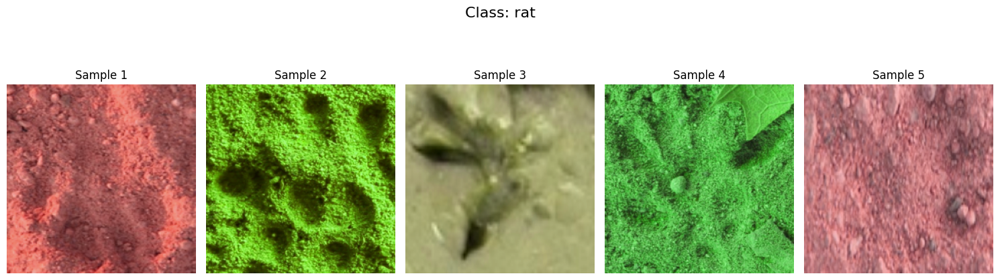

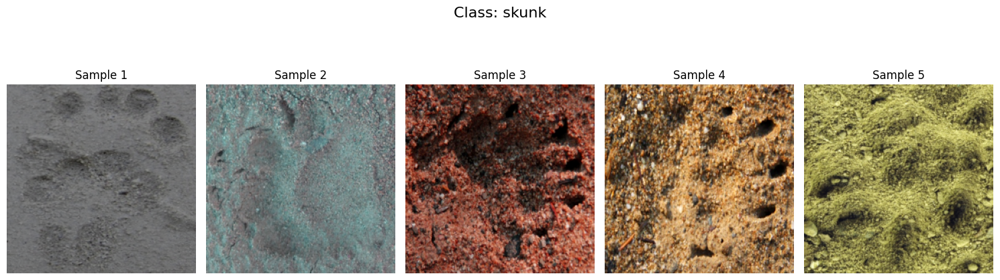

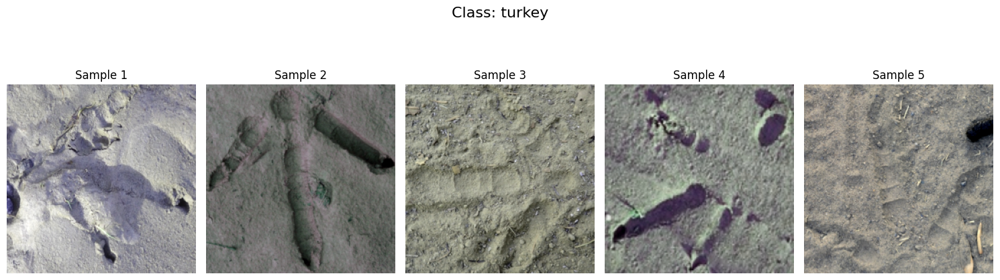

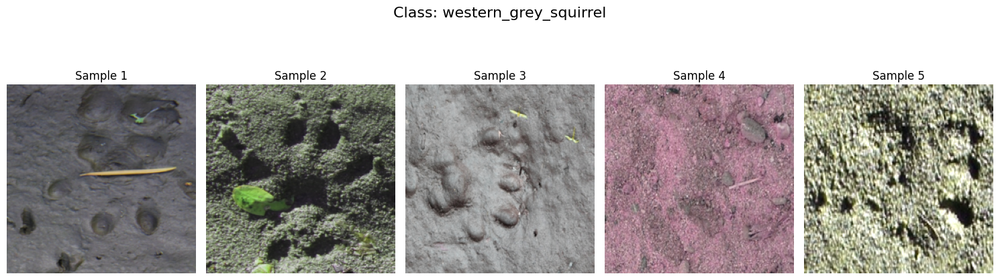

In [ ]:
def run_training():
    # Set random seeds for reproducibility
    torch.manual_seed(42)
    random.seed(42)
    np.random.seed(42)

    # Adjust this path according to your folder structure in Drive
    # For example, if cropped_imgs is directly under "Deep_Learning_Final_Project"
    data_root = "/content/drive/MyDrive/Deep_Learning_Final_Project/cropped_imgs"
    train_dir = os.path.join(data_root, "train")
    val_dir = os.path.join(data_root, "val")
    test_dir = os.path.join(data_root, "test")

    # Device configuration
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    # Define transformations
    train_transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
        transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    val_transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    # Create datasets
    train_dataset = AnimalTracksDataset(train_dir, transform=train_transform)
    val_dataset = AnimalTracksDataset(val_dir, transform=val_transform)
    test_dataset = AnimalTracksDataset(test_dir, transform=val_transform)

    # Create dataloaders with no workers (to avoid pickling issues)
    batch_size = 32
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

    # Print dataset information
    print(f"Number of training samples: {len(train_dataset)}")
    print(f"Number of validation samples: {len(val_dataset)}")
    print(f"Number of test samples: {len(test_dataset)}")
    print(f"Number of classes: {len(train_dataset.classes)}")
    print(f"Classes: {train_dataset.classes}")

    # Create the model
    model = models.resnet18()
    if hasattr(models.ResNet18_Weights, 'IMAGENET1K_V1'):
        model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
    else:
        model = models.resnet18(pretrained=True)

    num_classes = len(train_dataset.classes)
    # Replace the final fully connected layer to match the number of classes
    model.fc = nn.Linear(model.fc.in_features, num_classes)
    model = model.to(device)

    # Define loss function, optimizer, and scheduler
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-4)
    scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

    # Train the model with the gradual freezing/unfreezing strategy
    model, best_acc = train_model_with_freezing(model, train_loader, val_loader, criterion,
                                                 optimizer, scheduler, num_epochs=40, device=device,
                                                 freeze_epochs=5)

    # Save the best model
    os.makedirs("models", exist_ok=True)
    torch.save(model.state_dict(), "models/animal_tracks_model.pth")

    # Evaluate on the test set
    test_acc, test_cm = evaluate_model(model, test_loader, device, train_dataset.classes)
    print(f"Test accuracy: {test_acc:.4f}")

    # Display sample images from the training set
    print("Displaying sample images from the training set:")
    display_class_images(train_dataset, 5)

if __name__ == "__main__":
    run_training()